In [2]:
import os
import sys
sys.path.insert(0, "../utils")
import numpy as np
import matplotlib
from matplotlib import pyplot as plt
from tqdm import tqdm

import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.autograd import Variable
from torchvision.utils import save_image
import torchvision.transforms as transforms
from torchvision import datasets, models, transforms
import torchvision

from torch.utils.tensorboard import SummaryWriter
import shutil

plt.style.use('seaborn')
import seaborn as sns
sns.set_style("whitegrid", {'axes.grid' : False})


import helpers as h
import utils.utils as utils
import utils.visualizations as vis
import utils.cityscapes_loader as cityscapes_loader
import utils.train_eval as train_eval
from utils.train_eval import get_criterion
from utils.models import ResNetUNet


%load_ext autoreload
%autoreload 2


device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
device

/home/user/sheludzk/anaconda3/envs/CudaLab/lib/python3.8/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


device(type='cuda')

In [ ]:
# random seed
torch.manual_seed(42)

# Assignment 8

- Implement a UNet model:
    - Choose your own encoder and decoder
    - Residual connections

<center><img style="width: 40%" src="./resources/U-net.png"></center>
<!-- taken from https://arxiv.org/pdf/1505.04597.pdf -->

### Load dataset

In [3]:
dataset_root_dir = "/home/nfs/inf6/data/datasets/cityscapes/"

# train_ds = cityscapes_loader.cityscapesLoader(root=dataset_root_dir, split='train', is_transform=True)
# val_ds = cityscapes_loader.cityscapesLoader(root=dataset_root_dir, split='val', is_transform=True)

train_ds = cityscapes_loader.cityscapesLoader(root=dataset_root_dir, split='train', is_transform=True, img_size=(512, 1024), use_default_aug=False)
val_ds = cityscapes_loader.cityscapesLoader(root=dataset_root_dir, split='val', is_transform=True, img_size=(1024, 2048))

Found 2975 train images
Found 500 val images


In [4]:
train_loader = torch.utils.data.DataLoader(train_ds, batch_size=3, shuffle=True, num_workers=4, drop_last=True)
val_loader = torch.utils.data.DataLoader(val_ds, batch_size=3, shuffle=False, num_workers=4, drop_last=True)



In [ ]:


def show_samples_with_ground_truth(data_loader, n=8):
    fig, ax = plt.subplots(n, 2, figsize=(20,40))
    for i in range(n):
        img = data_loader.dataset[i][0].permute(1, 2, 0).numpy()
        # brg to rgb
        img = img[:, :, [2, 1, 0]]
       
        ax[i, 0].imshow(img)
        ground_truth = data_loader.dataset[i][1][0].numpy()
        ground_truth = data_loader.dataset.decode_segmap(ground_truth)
        ax[i, 1].imshow(ground_truth)
    plt.show()

#show_samples_with_ground_truth(train_loader, 8)

#### Augmentation
* Copy Blob <br>
Cityscapes dataset has a Class-Imbalance problem.<br>
Wall, fence, bus and train -classes have very low IoU.<br>
To make IoU of this classes higher, we can add the blobs containing the images of this objects to the images, which haven't had this classes before<br>
Idea and code taken from here: https://github.com/hoya012/semantic-segmentation-tutorial-pytorch/blob/master/learning/utils.py <br>
Here is an example of copyBlob:
<center><img style="width: 80%" src="./resources/copyBlobSample.png"></center>



* CutMix <br>
We can also apply CutMix-augmentation (https://arxiv.org/abs/1905.04899) to overcome the small size of original dataset

Application of this augmentations happens in train_epoch-function (train_eval.py)

In [ ]:

from utils.augmentation import copyblob
for j, (images, labels) in enumerate(val_loader):
    # images = images.to(device)
    # labels = labels.to(device)

    
    if j%2 == 1:
        for i in range(images.size()[0]):
            rand_idx = np.random.randint(images.size()[0])
            # wall(3) --> sidewalk(1)
            copyblob(src_img=images[i], src_mask=labels[i], dst_img=images[rand_idx], dst_mask=labels[rand_idx], src_class=3, dst_class=1)
            # fence(4) --> sidewalk(1)
            copyblob(src_img=images[i], src_mask=labels[i], dst_img=images[rand_idx], dst_mask=labels[rand_idx], src_class=4, dst_class=1)
            # bus(15) --> road(0)
            copyblob(src_img=images[i], src_mask=labels[i], dst_img=images[rand_idx], dst_mask=labels[rand_idx], src_class=15, dst_class=0)
            # train(16) --> road(0)
            copyblob(src_img=images[i], src_mask=labels[i], dst_img=images[rand_idx], dst_mask=labels[rand_idx], src_class=16, dst_class=0)

        decoded_label = val_ds.decode_segmap(labels[0][0].cpu().numpy())
        decoded_img = images[0].cpu().permute(1, 2, 0).numpy()


        fig, ax = plt.subplots(1, 2, figsize=(20, 10))
        ax[0].imshow(decoded_img)
        ax[1].imshow(decoded_label)
            # add titles
        ax[0].set_title("Image")
        ax[1].set_title("Ground Truth")
                

In [5]:


unet_res = ResNetUNet(n_class=19).to(device)
optimizer_unet_res = torch.optim.Adam(unet_res.parameters(), lr=0.001)

# criterion_unet_res = get_criterion(loss_type="focal", focal_gamma=0.8)
criterion_unet_res = get_criterion(loss_type="dice")
scheduler_unet_res = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer_unet_res, mode="min", factor=0.1, patience=10)


In [19]:
TBOARD_LOGS_unet_res = os.path.join(os.getcwd(), "tboard_logs/unet_res_dice", utils.timestamp())
utils.create_dir(TBOARD_LOGS_unet_res)

writer_unet_res = SummaryWriter(TBOARD_LOGS_unet_res)

In [20]:
# freeze backbone (for 3 epochs)
for param in unet_res.base_model.parameters():
    param.requires_grad = False
for param in unet_res.layer1.parameters():
    param.requires_grad = False
for param in unet_res.layer2.parameters():
    param.requires_grad = False
for param in unet_res.layer3.parameters():
    param.requires_grad = False
for param in unet_res.layer4.parameters():
    param.requires_grad = False


train_eval.train_model(unet_res, optimizer_unet_res, scheduler_unet_res, criterion_unet_res, train_loader, val_loader,
                num_epochs=3, tboard=None, start_epoch=0, device="cuda", writer=writer_unet_res, copy_blob=True, cut_mix=True, model_name="unet_res_dice")

# unfreeze backbone 
for params in unet_res.parameters():
    param.requires_grad = True

train_eval.train_model(unet_res, optimizer_unet_res, scheduler_unet_res, criterion_unet_res, train_loader, val_loader,
                num_epochs=50, tboard=None, start_epoch=3, device="cuda", writer=writer_unet_res, copy_blob=True, cut_mix=True, model_name="unet_res_dice")

  0%|          | 0/38 [00:05<?, ?it/s]


RuntimeError: Given groups=1, weight of size [512, 512, 1, 1], expected input[13, 1024, 8, 16] to have 512 channels, but got 1024 channels instead

In [ ]:
# train_eval.train_model(unet_res, optimizer_unet_res, scheduler_unet_res, criterion_unet_res, train_loader, val_loader,
#                 num_epochs=20, tboard=None, start_epoch=0, device="cuda", writer=writer_unet_res, copy_blob=True, cut_mix=True, model_name="unet_res")

100%|██████████| 62/62 [00:28<00:00,  2.20it/s]
/home/user/sheludzk/cudaLab/cudaLab/Assignment_8/utils/visualizations.py:280: MatplotlibDeprecationWarning: Passing the minor parameter of set_ticks() positionally is deprecated since Matplotlib 3.2; the parameter will become keyword-only two minor releases later.
  a.set_yticks([], [])
/home/user/sheludzk/cudaLab/cudaLab/Assignment_8/utils/visualizations.py:281: MatplotlibDeprecationWarning: Passing the minor parameter of set_ticks() positionally is deprecated since Matplotlib 3.2; the parameter will become keyword-only two minor releases later.
  a.set_xticks([], [])
  4%|▍         | 16/371 [00:27<09:21,  1.58s/it]

In [6]:
#utils.load_model(unet_res, optimizer=optimizer_unet_res, savepath="./checkpoints_unet_res_dice/checkpoint_epoch_51.pth")
#utils.load_model(unet_res, optimizer=optimizer_unet_res, savepath="./checkpoints_unet_res/checkpoint_epoch_20.pth")


(ResNetUNet(
   (base_model): ResNet(
     (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
     (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
     (relu): ReLU(inplace=True)
     (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
     (layer1): Sequential(
       (0): BasicBlock(
         (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
         (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
         (relu): ReLU(inplace=True)
         (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
         (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
       )
       (1): BasicBlock(
         (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
         (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1,

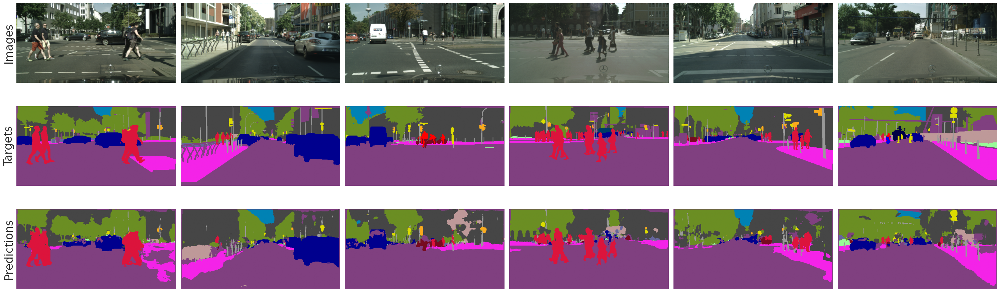

In [8]:
@torch.no_grad()
def add_visualization(model, eval_loader, device="cuda"):
    """ """
    imgs_arr, lbls_arr, preds_arr = [], [], []
    for i, (img, lbl) in enumerate(eval_loader):

        img = img.to(device)
        lbl[lbl == 250] = 0

        outputs = model(img) 
        _, preds = torch.max(outputs, 1)  

        
        imgs_arr.append(img.cpu())
        lbls_arr.append(lbl.cpu())
        preds_arr.append(preds.cpu())
        break
    imgs_arr = torch.cat(imgs_arr, dim=0)
    lbls_arr = torch.cat(lbls_arr, dim=0)
    preds_arr = preds

    fig, ax = vis.qualitative_evaluation(imgs_arr, lbls_arr, preds_arr)
    #writer.add_figure("Qualitative Eval", fig, global_step=epoch)

    return

add_visualization(unet_res, val_loader, device="cuda")

preds.shape torch.Size([13, 256, 512])
image.shape torch.Size([13, 3, 256, 512])
label.shape torch.Size([13, 1, 256, 512])


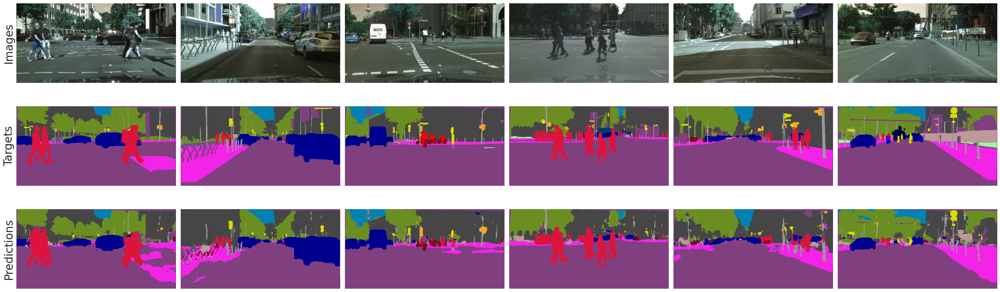

In [13]:
add_visualization(unet_res, val_loader, device="cuda")

Here are some examples of the work of UNet with Resnet Backbone
We have also experimented with ConvNExt-like backbone, the results of UNet with ConvNExt can be found in Assignment_8/test_convUnext.ipynb

/tmp/ipykernel_396230/1412208519.py:12: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(1, 3, figsize=(20, 10))


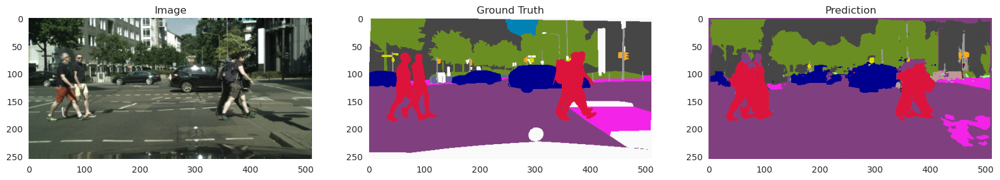

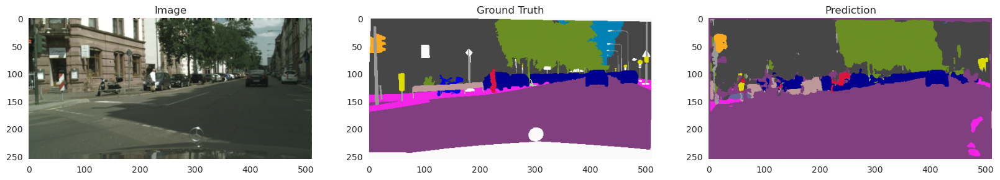

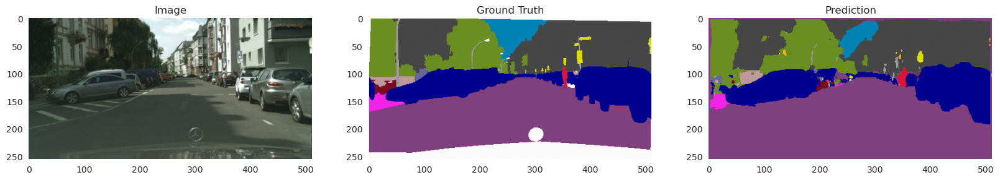

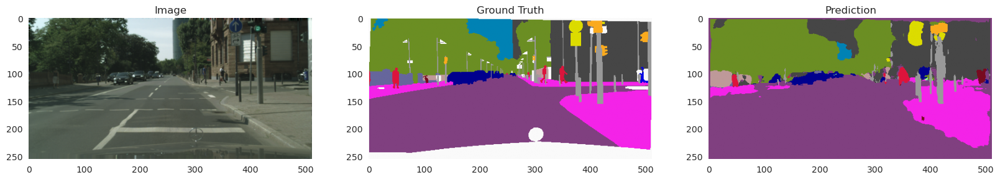

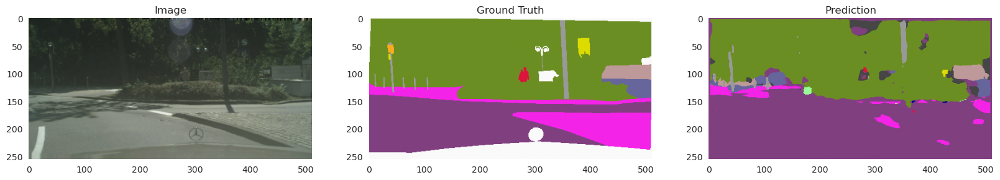

...

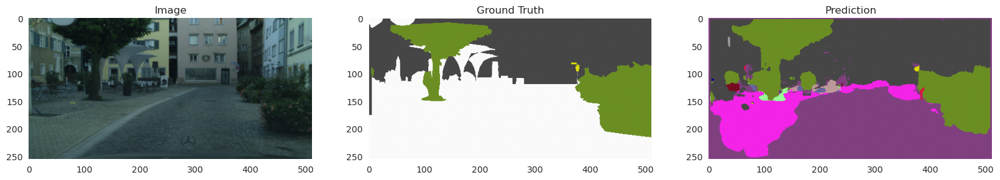

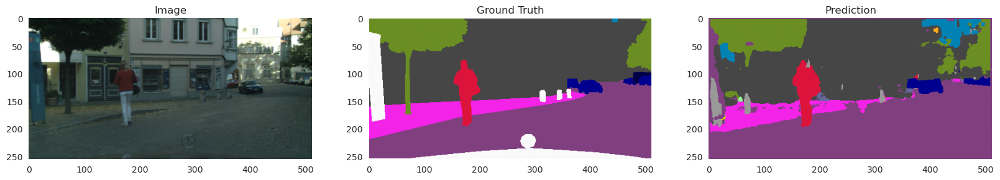

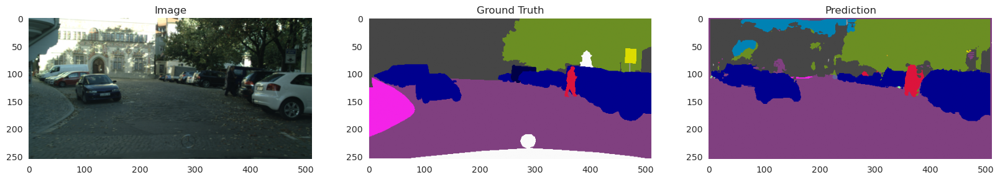

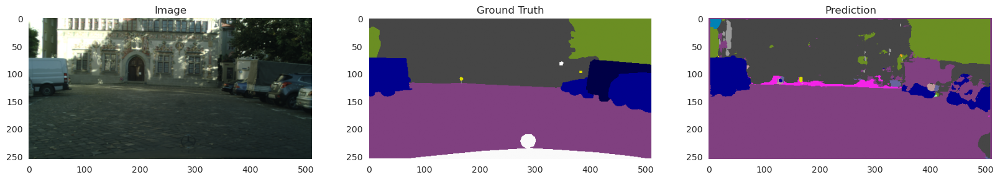

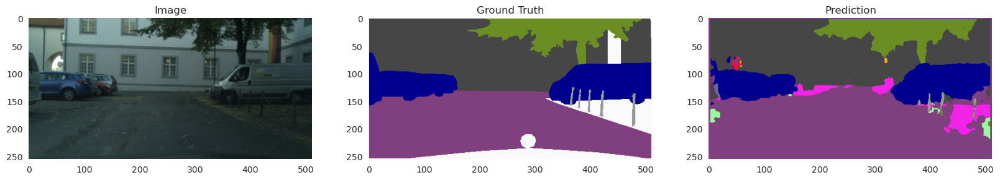

In [9]:
unet_res.eval()
with torch.no_grad():
    for i, (images, labels) in enumerate(val_loader):
        images = images.to(device)
        labels = labels.to(device)
        outputs = unet_res(images)
        _, preds = torch.max(outputs, 1)
        if True:
            decoded_pred = val_ds.decode_segmap(preds[0].cpu().numpy())
            decoded_label = val_ds.decode_segmap(labels[0][0].cpu().numpy())
            decoded_img = images[0].cpu().permute(1, 2, 0).numpy()
            fig, ax = plt.subplots(1, 3, figsize=(20, 10))
            ax[0].imshow(decoded_img)
            ax[1].imshow(decoded_label)
            ax[2].imshow(decoded_pred)
            # add titles
            ax[0].set_title("Image")
            ax[1].set_title("Ground Truth")
            ax[2].set_title("Prediction")
        